# SatVision Inference Using Triton Server

This Jupyter Notebook demonstrates how to perform inference using the SatVision foundation model deployed on a Triton Inference Server. It walks through the end-to-end process of formatting inputs, sending requests to the server, and retrieving model predictions. The notebook is designed to support high-throughput inference for multi-channel MODIS TOA data, leveraging GPU acceleration and Triton’s efficient serving capabilities for scalable downstream applications.

## 1. Download Configuration Dependencies

### 1.1. Download SatVision Repository

In [1]:
import os
import sys
import urllib
import subprocess
import gevent.ssl
import numpy as np
import matplotlib.pyplot as plt
import tritonclient.http as httpclient

from glob import glob
from tqdm import tqdm
from huggingface_hub import hf_hub_download
from huggingface_hub import snapshot_download

/Users/jacaraba/.local/share/mamba/envs/triton-infer-env3/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
repo_url = "https://github.com/nasa-nccs-hpda/satvision-toa"
if not os.path.exists('satvision-toa'):
    subprocess.run(["git", "clone", repo_url, 'satvision-toa'], check=True)
    print(f"Cloned {repo_url} into satvision-toa")
else:
    print("Repository already exists.")

Repository already exists.


In [3]:
config_url = "https://huggingface.co/nasa-cisto-data-science-group/" + \
    "satvision-toa-giant-patch8-window8-128/resolve/main/" + \
    "mim_pretrain_swinv2_satvision_giant_128_window08_50ep.yaml"
config_output_path = os.path.join("mim_pretrain_swinv2_satvision_giant_128_window08_50ep.yaml")

In [4]:
if not os.path.exists(config_output_path):
    urllib.request.urlretrieve(config_url, config_output_path)
    print(f"Downloaded to {config_output_path}")

### 1.2. Setup SatVision Dependencies

In [5]:
# setting up the path and dependencies
sys.path.append('satvision-toa')
from satvision_toa.models.mim import build_mim_model
from satvision_toa.transforms.mim_modis_toa import MimTransform
from satvision_toa.configs.config import _C, _update_config_from_file
from satvision_toa.plotting.modis_toa import plot_export_pdf

/Users/jacaraba/.local/share/mamba/envs/triton-infer-env3/lib/python3.10/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)


## 1.3 Load SatVision Configuration

In [6]:
# load model config
config = _C.clone()
_update_config_from_file(config, config_output_path)

=> merge config from mim_pretrain_swinv2_satvision_giant_128_window08_50ep.yaml


# 2. Setup Triton Server Client

In [7]:
triton_server_url = "gs6n-dgx02.sci.gsfc.nasa.gov"

In [8]:
# Initialize the Triton client
ssl_context_factory = gevent.ssl._create_unverified_context
client = httpclient.InferenceServerClient(
    url=triton_server_url,
    ssl=True,
    insecure=True,
    ssl_context_factory=ssl_context_factory
)

# 3. Download Data from HuggingFace

In [9]:
hf_dataset_repo_id: str = 'nasa-cisto-data-science-group/modis_toa_cloud_reconstruction_validation'

In [10]:
validation_tiles_dir = snapshot_download(repo_id=hf_dataset_repo_id, allow_patterns="*.npy", repo_type='dataset')
validation_tiles_regex = os.path.join(validation_tiles_dir, '*.npy')
validation_tiles_filename = next(iter(glob(validation_tiles_regex)))
validation_tiles = np.load(validation_tiles_filename)
validation_tiles.shape

Fetching 1 files: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 11915.64it/s]


(128, 128, 128, 14)

# 3. Perfom Inference

## 3.1 Apply Transform

This section will be performed at the triton server at a later time.

In [11]:
# Use the Masked-Image-Modeling transform specific to MODIS TOA data
transform = MimTransform(config)

In [12]:
# Apply transform to each image in the batch
# A mask is auto-generated in the transform
images_and_masks = [transform(validation_tiles[idx]) for idx \
    in range(validation_tiles.shape[0])]

# Seperate img and masks, cast masks to torch tensor
images = np.stack([image_mask_list[0] for image_mask_list in images_and_masks])
masks = np.stack([image_mask_list[1] for image_mask_list in images_and_masks])

## 3.2 Run Inference

In [13]:
import torch

input_images = []
input_masks = []
output_images = []

for i in tqdm(range(validation_tiles.shape[0])):

    single_image, single_mask = np.expand_dims(images[i], 0), np.expand_dims(masks[i], 0).astype(bool)

    # Prepare input tensors
    image_tensor = httpclient.InferInput("image", single_image.shape, "FP32")
    image_tensor.set_data_from_numpy(single_image)

    mask_tensor = httpclient.InferInput("mask", single_mask.shape, "BOOL")
    mask_tensor.set_data_from_numpy(single_mask)

    # Specify output tensor
    output_tensor = httpclient.InferRequestedOutput("output")

    # Perform inference
    response = client.infer(
        model_name="satvision_toa_model",
        inputs=[image_tensor, mask_tensor],
        outputs=[output_tensor]
    )

    # Retrieve and print output
    input_images.append(torch.from_numpy(np.squeeze(single_image)))
    input_masks.append(torch.from_numpy(np.squeeze(single_mask)))
    output_images.append(torch.from_numpy(np.squeeze(response.as_numpy("output"))))

# output reconstructions
print(f"Reconstructed {len(output_images)} images")

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 128/128 [04:20<00:00,  2.04s/it]

Reconstructed 128 images


In [14]:
input_images[0].shape

torch.Size([14, 128, 128])

/Users/jacaraba/Desktop/development/ilab-triton/notebooks/satvision-toa/satvision_toa/plotting/modis_toa.py:57: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, (ax01, ax23) = plt.subplots(2, 2, figsize=(40, 30))


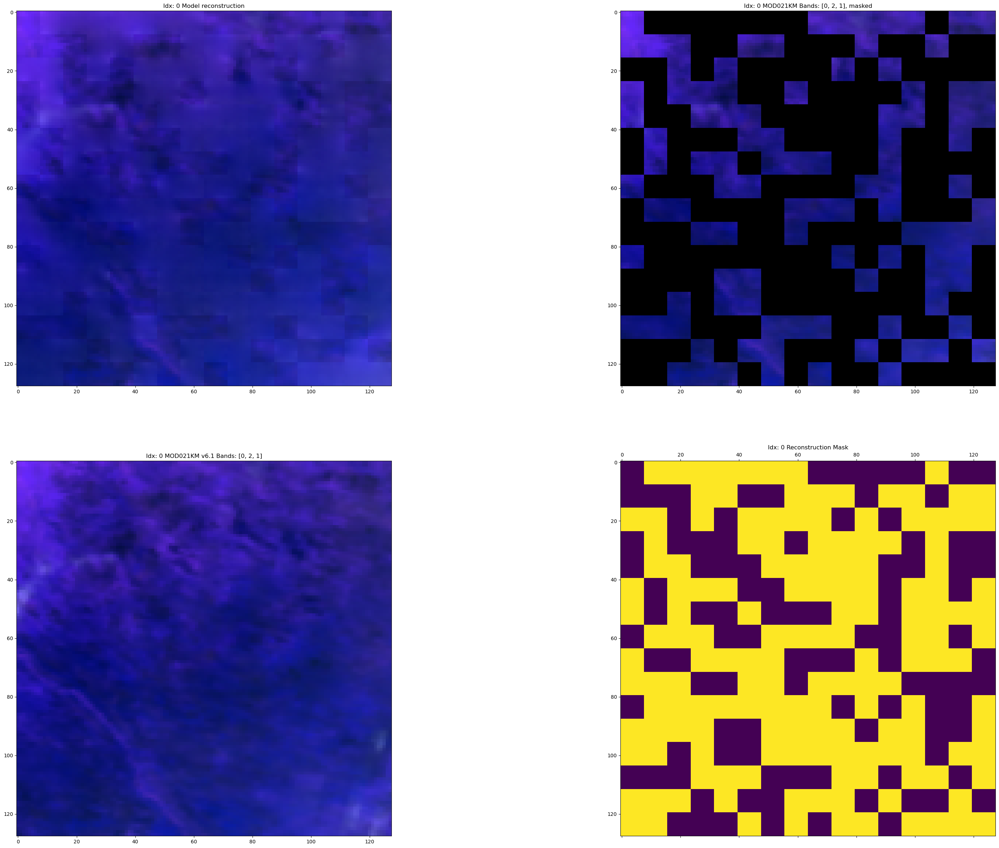

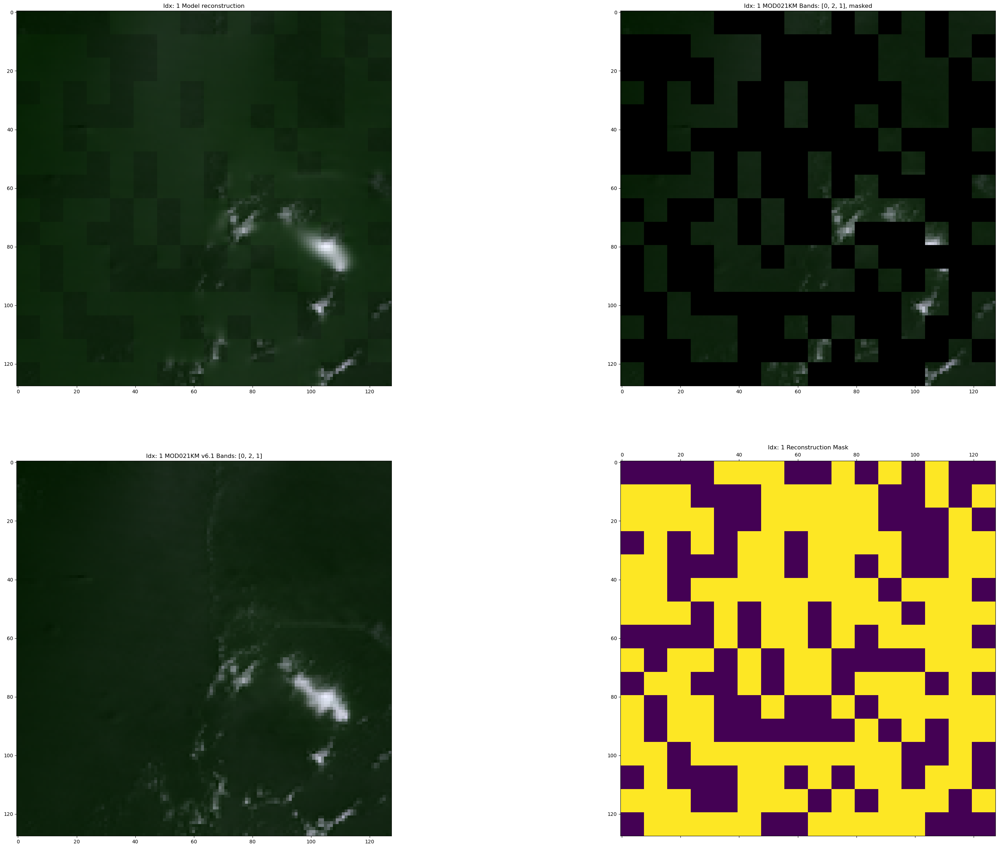

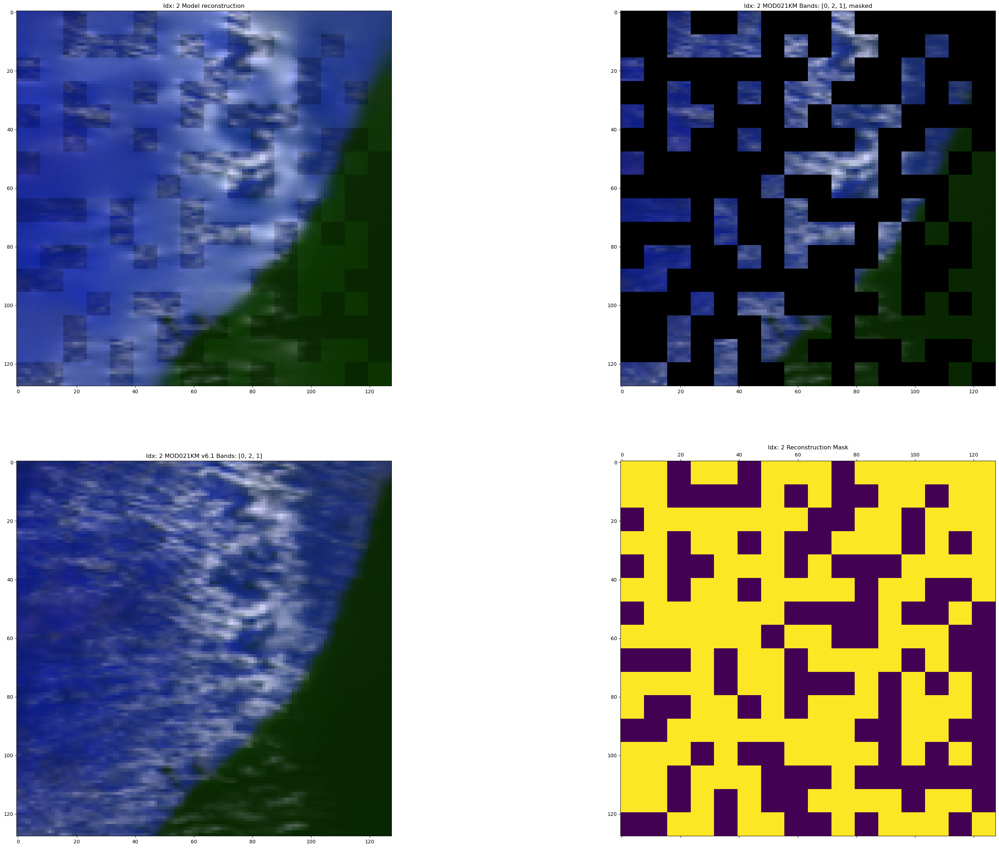

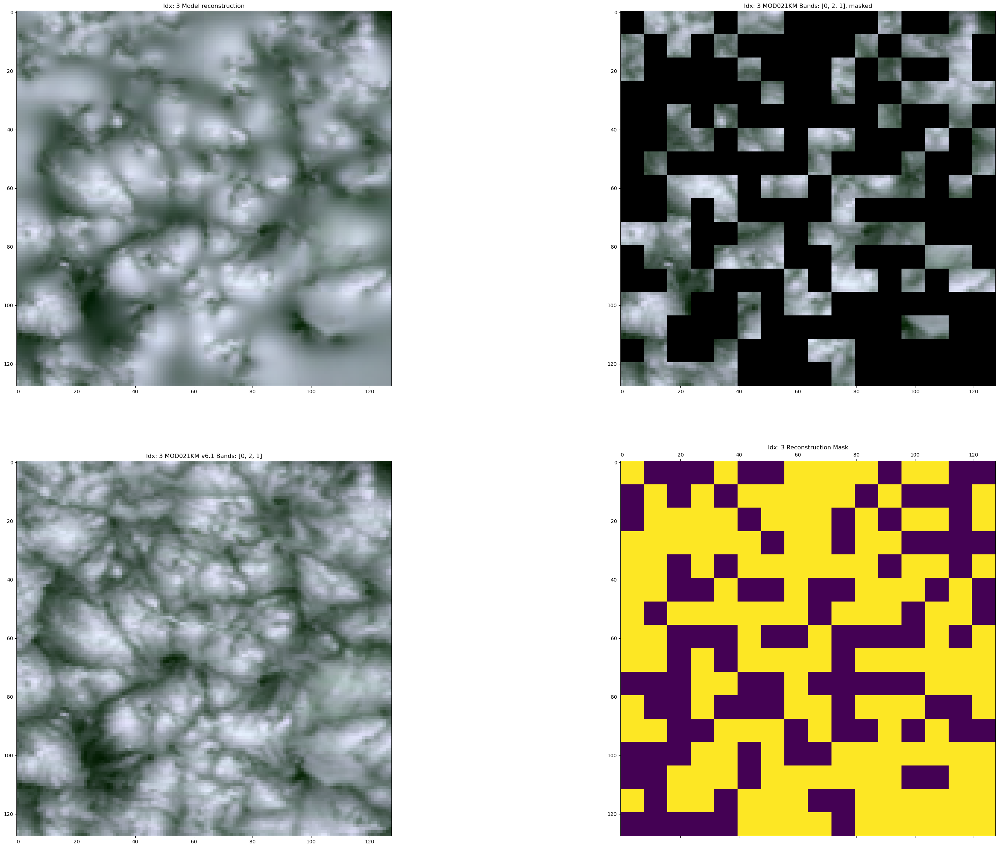

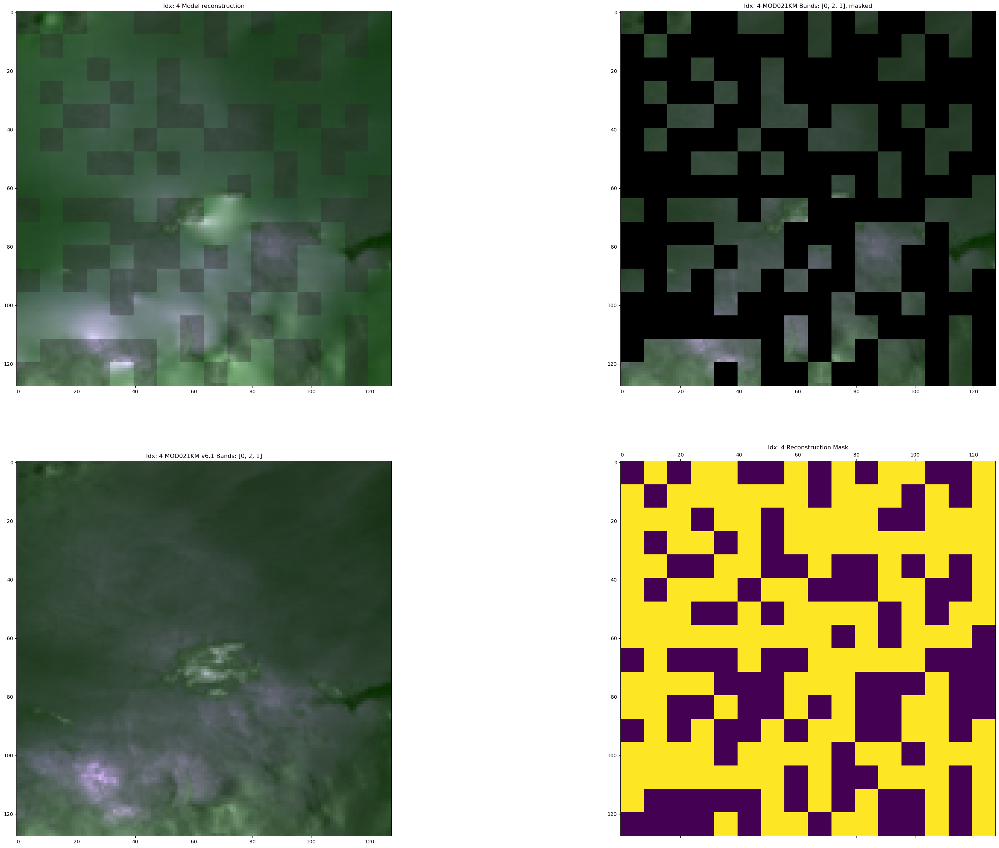

...

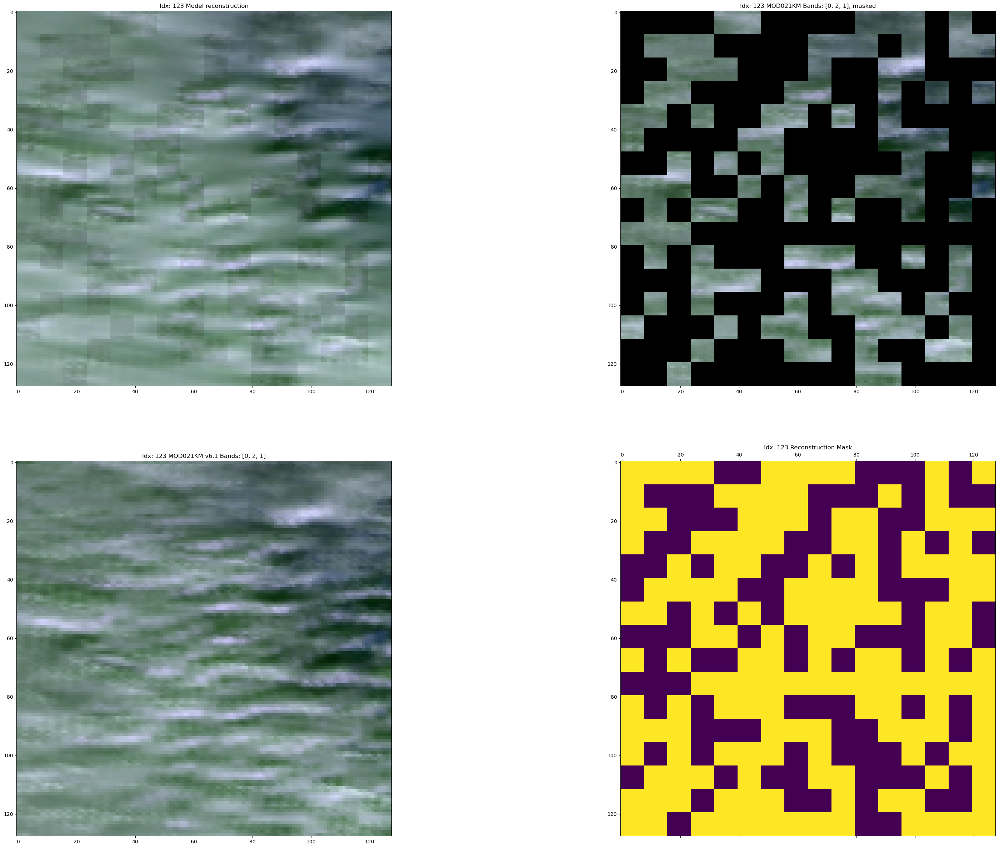

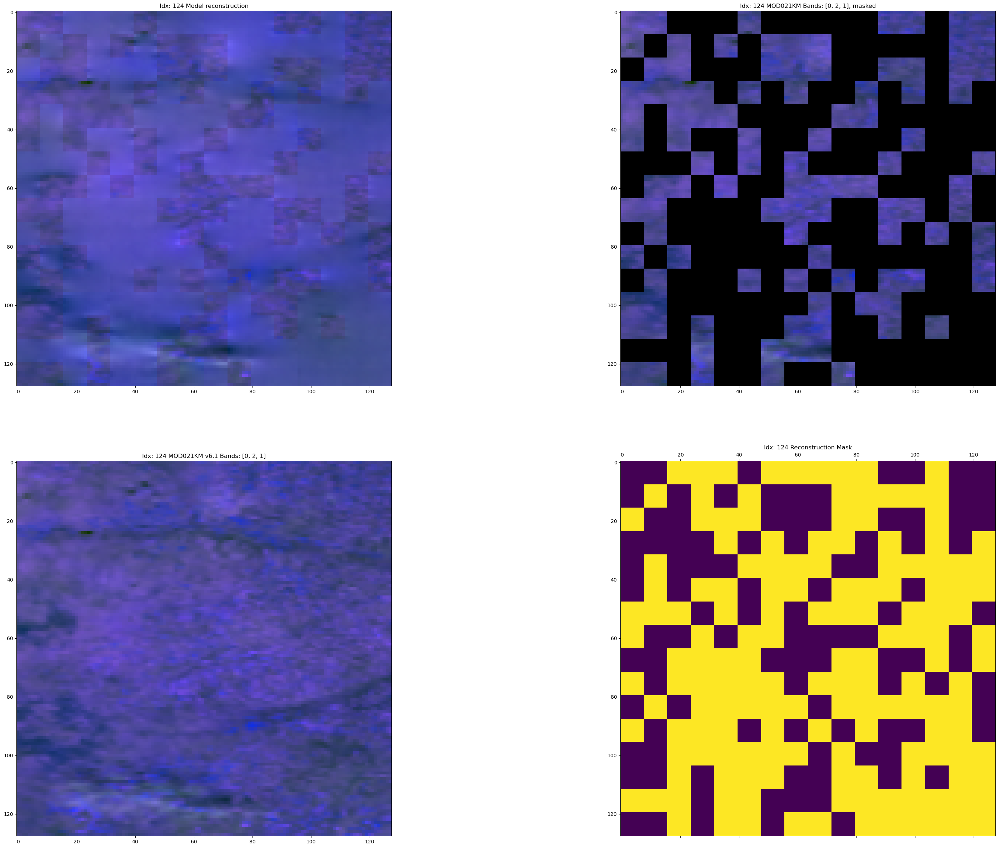

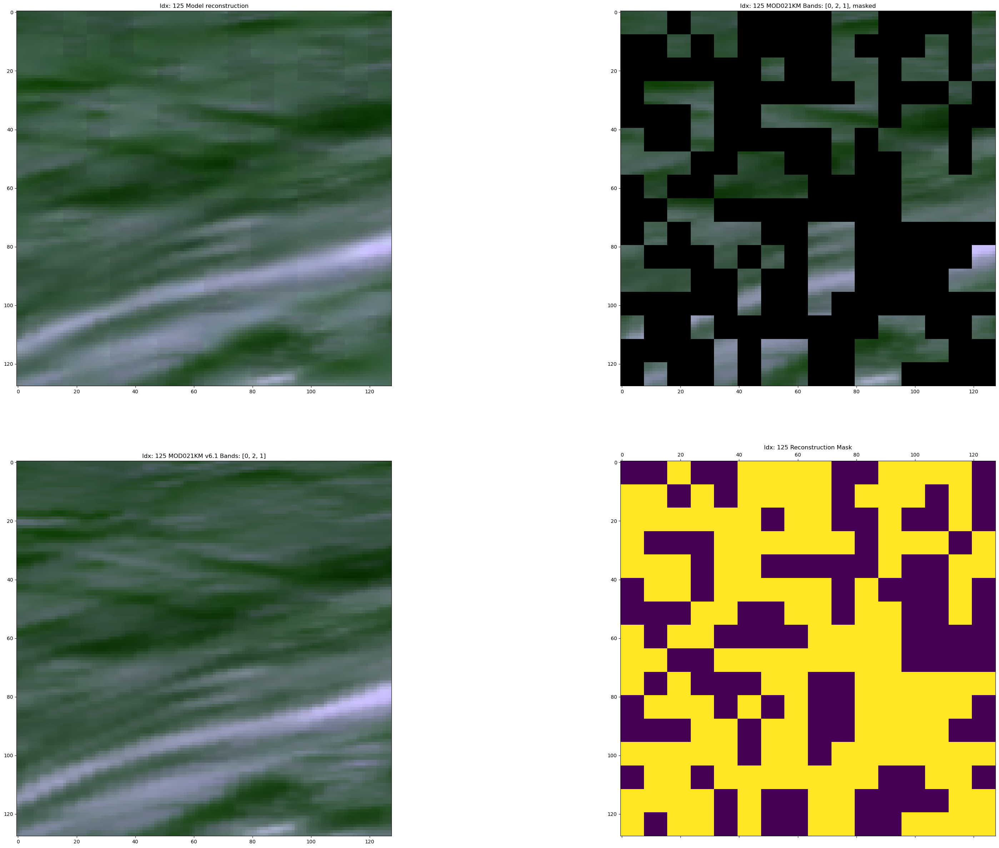

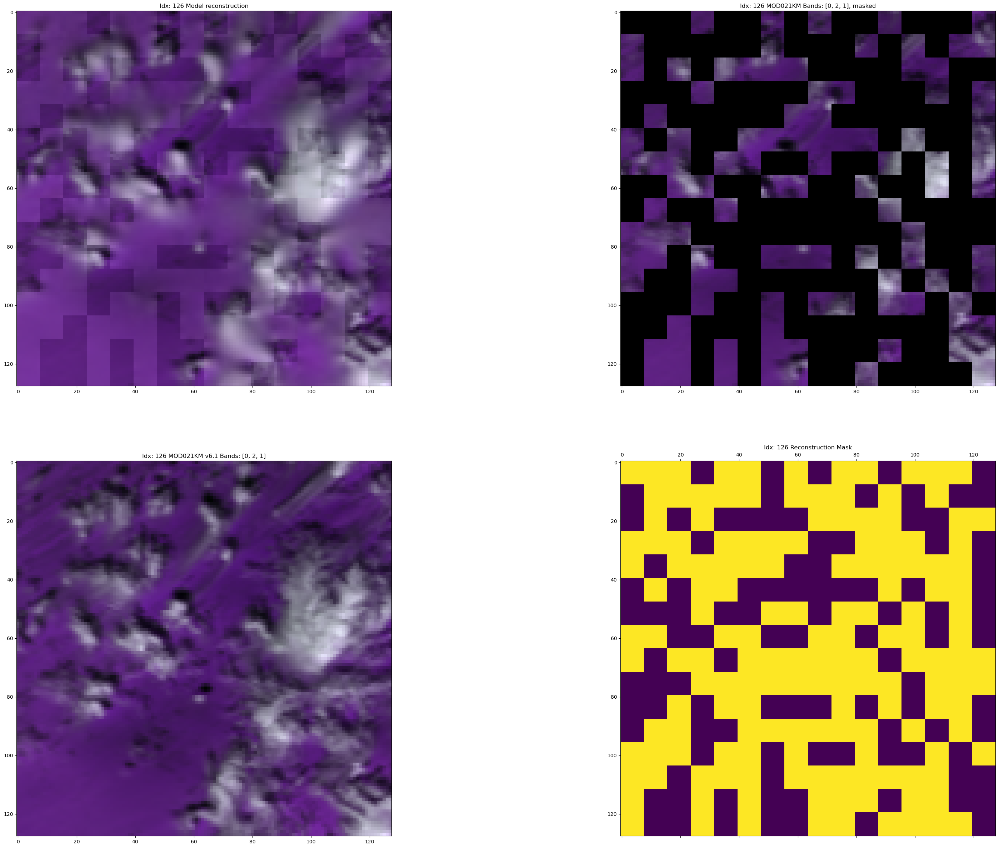

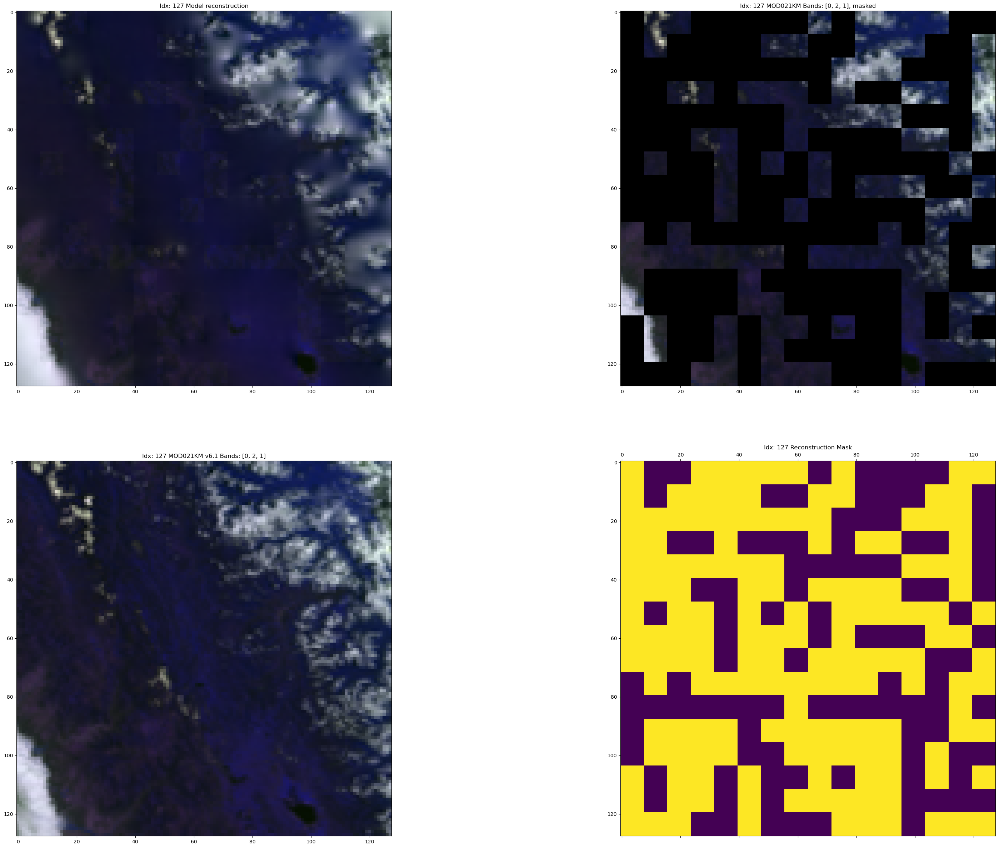

In [15]:
rgb_index = [0, 2, 1]
plot_export_pdf('reconstructions.pdf', input_images, output_images, input_masks, rgb_index)